In [1]:
!pip install segmentation-models-pytorch
!pip install albumentations
!pip install tqdm
!pip install segmentation_models_p
!pip install pytorch-toolbelt
!pip install --upgrade scikit-image tifffile
!pip install matplotlib

import os
import sys
import numpy as np
import segmentation_models_pytorch as smp
import torch
import torch.nn as nn

from segmentation_models_pytorch.utils.train import TrainEpoch, ValidEpoch

import segmentation_models_pytorch.metrics
import tifffile
import albumentations as A
from matplotlib import pyplot as plt
import skimage.io
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import random
sys.path.append("..") 

from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import jaccard_score

import tqdm

class JointLoss(nn.Module):
    def __init__(self, dice_weight=1, focal_weight=0.5):
        super(JointLoss, self).__init__()
        self.dice_loss = smp.losses.DiceLoss(mode='multilabel', ignore_index=[0])
        self.focal_loss = smp.losses.FocalLoss(mode='multilabel', ignore_index=[0])
        self.dice_weight = dice_weight
        self.focal_weight = focal_weight
    def forward(self, y_pred, y_true):
        dice_loss = self.dice_loss(y_pred, y_true)
        focal_loss = self.focal_loss(y_pred, y_true)

        joint_loss = self.dice_weight * dice_loss + self.focal_weight * focal_loss

        return joint_loss

  Obtaining dependency information for segmentation-models-pytorch from https://files.pythonhosted.org/packages/cb/70/4aac1b240b399b108ce58029ae54bc14497e1bbc275dfab8fd3c84c1e35d/segmentation_models_pytorch-0.3.3-py3-none-any.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Obtaining dependency information for timm==0.9.2 from https://files.pythonhosted.org/packages/29/90/94f5deb8d76e24a89813aef95e8809ca8fd7414490428480eda19b133d4a/timm-0.9.2-py3-none-any.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.5/68.5 kB 7.3 MB/s eta 0:00:00
  Obtaining dependency information for munch from https://files.pythonhosted.org/packages/56/b3/7c69b37f03260a061883bec0e7b05be7117c1b1c85f5212c72c8c2bc3c8c/munch-4.0.0-py2.py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.7/106.7 kB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


### Utils 

In [2]:
palette ={ 0 : (0,0,0),  #no data
           1 : (128, 255, 0), #forest -
           2 : (166, 0, 204), #mine-
           3 : (204, 0, 0), #road-
           4 : (255, 0, 0), #disc urban   -
           5 : (255, 255, 168), #arable land-
           6 : (255,230,166), #heteregonous agricultural areas -
           7 : (231, 40, 252), #permenant crops -
           8 : (0, 204, 242),  #inland waters -
           9 : (255, 166, 255),  #artificial non-agricultural vegetated areas-
         }

invert_palette = {v: k for k, v in palette.items()}

def convert_to_color(arr_2d, palette=palette):
    """ Numeric labels to RGB-color encoding """
    arr_3d = np.zeros((arr_2d.shape[0], arr_2d.shape[1], 3), dtype=np.uint8)

    for c, i in palette.items():
        m = arr_2d == c
        arr_3d[m] = i

    return arr_3d

def convert_from_color(arr_3d, palette=invert_palette):
    """ RGB-color encoding to grayscale labels """
    arr_2d = np.zeros((arr_3d.shape[0], arr_3d.shape[1]), dtype=np.uint8)

    for c, i in palette.items():
        m = np.all(arr_3d == np.array(c).reshape(1, 1, 3), axis=2)
        arr_2d[m] = i

    return arr_2d

# helper function for data visualization
def visualize_in_one_row(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()
    
def scale_range(input, min, max):
    input += -(np.min(input))
    input /= (1e-9 + np.max(input) / (max - min + 1e-9))
    input += min
    return input

def show_image(im,target_file): #PCG
      if len(im.shape) == 2:
        im = scale_range(im, 0, 255).astype(np.uint8)
        plt.figure(figsize=(16, 16), dpi= 80, facecolor='w', edgecolor='k')
        plt.imshow(im,cmap='gray')
        plt.show()

      elif len(im.shape) == 3:
        im = np.array([scale_range(i, 0, 255) for i in im.transpose((2,0,1))]).transpose(1,2,0)[...,:3].astype(np.uint8)
        plt.figure(figsize=(16, 16), dpi= 80, facecolor='w', edgecolor='k')
        plt.savefig(target_file, format = 'png', dpi =80,  transparent = True, bbox_inches = 'tight', pad_inches = 0)
        plt.imshow(im)
        plt.show()

def seed_everything(seed):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    
def evaluate(model, generator):
    """ usage:
        from sklearn.metrics import classification_report
        y_pred, y = evaluate(best_model, generator)
        y_pred  = np.hstack(y_pred)
        y = np.hstack(y)
        targets = ['building', 'not_building']
        print(classification_report(y, y_pred, target_names = targets))#, output_dict = True)
    """
    
    best_model = model
    best_model.cuda()
    best_model.eval()

    y_preds = list()
    ys = list()
    with torch.no_grad():
        for idx in tqdm.tqdm(range(len(generator))):
            X,y = generator[idx]
            #X = X.detach().cpu().numpy()
            y = y.detach().cpu().numpy()
            gt_max = np.argmax(y, axis=0)
            #gt_colora = convert_to_color(gt_max)
            logsoftmax = best_model.forward(X[None,:,:])
            y_pred = logsoftmax.argmax(dim=1)
            y_pred = y_pred.squeeze()
            gt_color = torch.as_tensor(gt_max).cuda()
            gt_color = gt_color.detach().cpu().numpy().flatten()
            y= gt_color 
            y_pred = y_pred.flatten().detach().cpu().numpy()
            
            ys.append(y)
            y_preds.append(y_pred)
            
    best_model.cpu()
    return y_preds, ys    
    
def collate_fn(batch):
    batch = list(filter(lambda x: x is not None, batch))
    out = torch.utils.data.dataloader.default_collate(batch)
    print("len batch",len(out))
    return out

Class_names = ['NoData',
               'Forest',
               'Mine, dump and construction sites',
                'Road and Rail',
                'Discontinious Urban Fabric',
               'Arable Land',
               'Heterogeneous agricultural areas',
                'Permenant Crops',
                'Inland Waters',
                'Artificial, non-agricultural vegetated areas'] 

### Calculate mean and std 

In [ ]:
def _compute_stats_for_image(file_path: str) -> (np.ndarray, np.ndarray):

        image = skimage.io.imread(file_path, plugin='tifffile')

        mean = image.mean((0, 1))
        std = image.std((0, 1))

        assert mean.shape == (4,), f'mean had shape {mean.shape}'
        assert std.shape == (4,), f'std had shape {std.shape}'

        return mean, std


def _compute_stats_for_dir(dir_name) -> ([np.ndarray], [np.ndarray]):
    if not os.path.isdir(dir_name):
        raise ValueError(f'Directory does not exist: {dir}')

    means = []
    stds = []

    for dir_path, _, file_names in os.walk(dir_name):
        for file_name in file_names:
            mean, std = _compute_stats_for_image(os.path.join(dir_path, file_name))
            means.append(mean)
            stds.append(std)

    return means, stds

from PIL import Image
means, stds = _compute_stats_for_dir(r"/kaggle/input/aksudataa/Aksu/Train/Image")

mean_= np.asarray(means) 
mean__ = mean_[~np.isnan(mean_).any(axis=1)]
mean_mean = np.mean(mean__, axis = 0)

stds_ = np.asarray(stds) 
stds__ = stds_[~np.isnan(stds_).any(axis=1)]
stds_mean = np.mean(stds__, axis = 0)
print("MEAN", mean_mean)
print("STD",stds_mean)


### Dataset Instance 

In [3]:
#tiff 
from tifffile import TiffFile
class MM_Dataset(Dataset):  
    def __init__(
            self, 
            dataset_dir,
            mode,
            transform=None, 
            preprocessing=None,
            sample_ids = False):

        self.dataset_dir = dataset_dir
        self.transform = transform
        self.preprocessing = preprocessing
        self.class_values = np.arange(0,10,1)
        self.sample_ids = sample_ids
        
        if mode == 'train':
            
            self.train_dir = os.path.join(self.dataset_dir, 'Train')
            
            optic_dir = os.path.join(self.train_dir, 'Image')
            mask_dir = os.path.join(self.train_dir, 'Mask')
            
            self.optic_ids = sorted(os.listdir(optic_dir))
            self.mask_ids = sorted(os.listdir(mask_dir))

            self.optic_fps = [os.path.join(optic_dir, image_id) for image_id in self.optic_ids]
            self.mask_fps = [os.path.join(mask_dir, image_id) for image_id in self.mask_ids]
            print("Training set: {} image".format(len(self.optic_ids)))
            
        if mode == 'val':
            
            self.train_dir = os.path.join(self.dataset_dir, 'Validation')
            
            optic_dir = os.path.join(self.train_dir, 'Image')
            mask_dir = os.path.join(self.train_dir, 'Mask')
            
            self.optic_ids = sorted(os.listdir(optic_dir))
            self.mask_ids = sorted(os.listdir(mask_dir))

            self.optic_fps = [os.path.join(optic_dir, image_id) for image_id in self.optic_ids]
            self.mask_fps = [os.path.join(mask_dir, image_id) for image_id in self.mask_ids]
            print("Validation set: {} image".format(len(self.optic_ids)))
            
        elif mode == 'test':
            
            self.test_dir = os.path.join(self.dataset_dir, 'Test')
            
            optic_dir = os.path.join(self.test_dir, 'Image')
            mask_dir = os.path.join(self.test_dir, 'Mask')
            
            self.optic_ids = sorted(os.listdir(optic_dir))
            self.mask_ids = sorted(os.listdir(mask_dir))

            self.optic_fps = [os.path.join(optic_dir, image_id) for image_id in self.optic_ids]
            self.mask_fps = [os.path.join(mask_dir, image_id) for image_id in self.mask_ids]
            print("Test set: {} image".format(len(self.optic_ids)))

    @staticmethod
    
    def _read_img(image_path):
        try:
            with TiffFile(image_path) as tif:
                return tif.asarray()
        except Exception as e:
            print(f"Error reading {image_path}: {e}")
            return None

    def __len__(self):
        return len(self.mask_ids)
    
    def __getitem__(self, idx):

        optic_id = self.optic_fps[idx].split('\\')[-1]
        mask_id = self.mask_fps[idx].split('\\')[-1]

        optic_filepath = self.optic_fps[idx] 
        mask_filepath = self.mask_fps[idx]

        try:
            image = self._read_img(optic_filepath)
        except TiffFileError as e:
            print(f"Error reading {optic_filepath}: {e}")
            image = None
    
        mask = self._read_img(mask_filepath)
        mask = mask.astype('uint8')

        if image is None or mask is None:
            # Handle error case, return None
            return None

        if self.transform is not None:
            transformed = self.transform(image=image, mask=mask)
            image = transformed["image"]
            mask = transformed["mask"]

        if self.preprocessing:
            preprocessed = self.preprocessing(image=image, mask=mask)
            image, mask = preprocessed['image'], preprocessed['mask']

        mask_raw = convert_from_color(mask)

        masks = [(mask_raw == v) for v in self.class_values]
        mask = np.stack(masks, axis=-1)

        image = image.transpose(2, 0, 1).astype('float32')
        mask = mask.transpose(2, 0, 1).astype('float32')

        image = torch.as_tensor(image, dtype=torch.float32).cuda() 
        mask = torch.as_tensor(mask, dtype=torch.float32).cuda()
    
        if self.sample_ids is not False:
            return image, mask, optic_id

        return image, mask

In [4]:
#aksu
train_transform = A.Compose([
  A.PadIfNeeded(512,512),
  A.RandomRotate90(),
  A.Flip(),
  A.ShiftScaleRotate(shift_limit=0.2, scale_limit=0.2, rotate_limit=30, p=0.5),
  A.Normalize(mean=[279, 345, 199, 592], std=[59, 95, 93, 200]) 
])

val_transform = A.Compose([
  A.PadIfNeeded(512, 512),
  A.Normalize(mean=[279, 345, 199, 592], std=[59, 95, 93, 200])  
])

test_transform = A.Compose([
  A.PadIfNeeded(512, 512), 
  A.Normalize(mean=[279, 345, 199, 592], std=[59, 95, 93, 200])
])




In [5]:
SEED = 33
seed_everything(SEED)
dataset_dir = r"/kaggle/input/aksudata/Aksu"

In [6]:
train_dataset = MM_Dataset(dataset_dir = dataset_dir,
                    mode='train',
                    transform = train_transform)

val_dataset = MM_Dataset(dataset_dir = dataset_dir,
                    mode='val',
                    transform = val_transform)

test_dataset = MM_Dataset(dataset_dir = dataset_dir,
                    mode='test',
                    transform = test_transform)

Training set: 419 image
Validation set: 120 image
Test set: 60 image


### Sampling technique  

In [7]:
from sklearn.utils import compute_sample_weight
from pytorch_toolbelt.utils import fs
from torch.utils.data import WeightedRandomSampler

def get_balanced_weights(dataset):
    labels=[]
    for mask in dataset.mask_fps:
        mask = fs.read_image_as_is(mask)
        unique_labels = np.unique(mask)
        labels.append(''.join([str(int(i)) for i in unique_labels]))

    weights = compute_sample_weight('balanced', labels)
    return weights

In [8]:
mul_factor =  5
train_sampler = WeightedRandomSampler(get_balanced_weights(train_dataset), len(train_dataset) * mul_factor)
val_sampler = WeightedRandomSampler(get_balanced_weights(val_dataset), len(val_dataset) * mul_factor)

### Sanity Check 

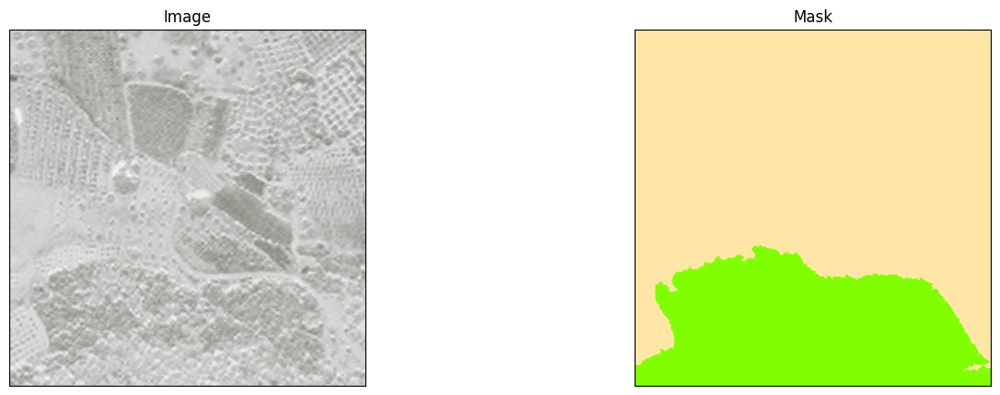

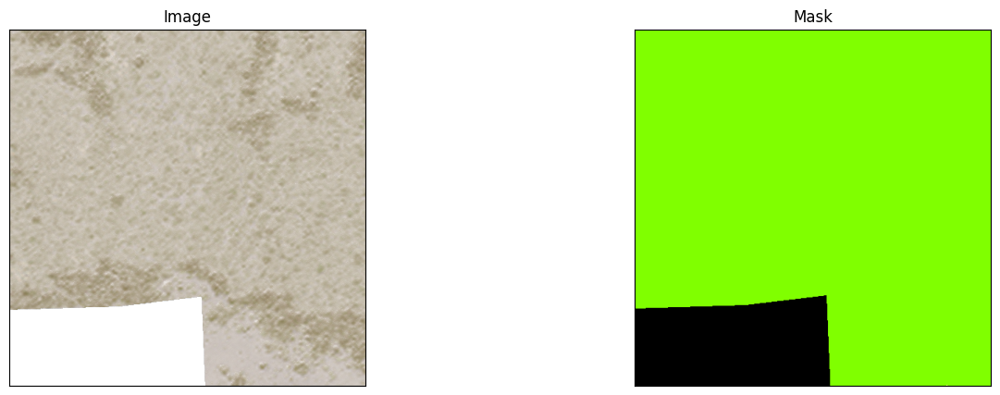

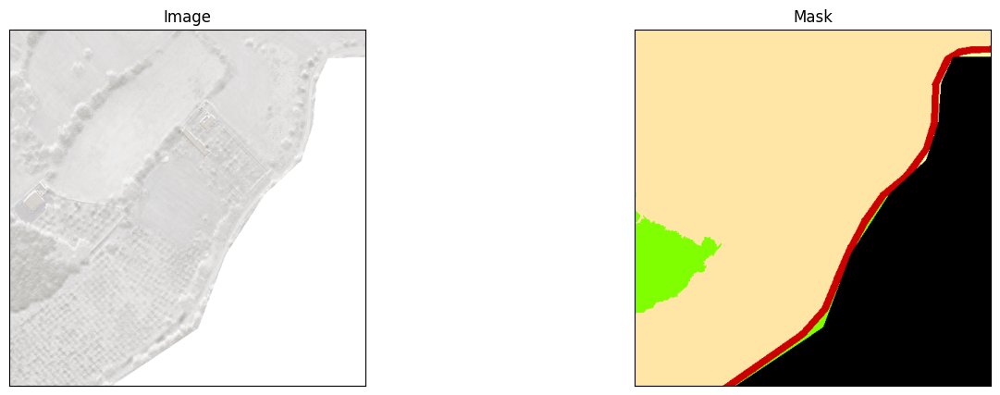

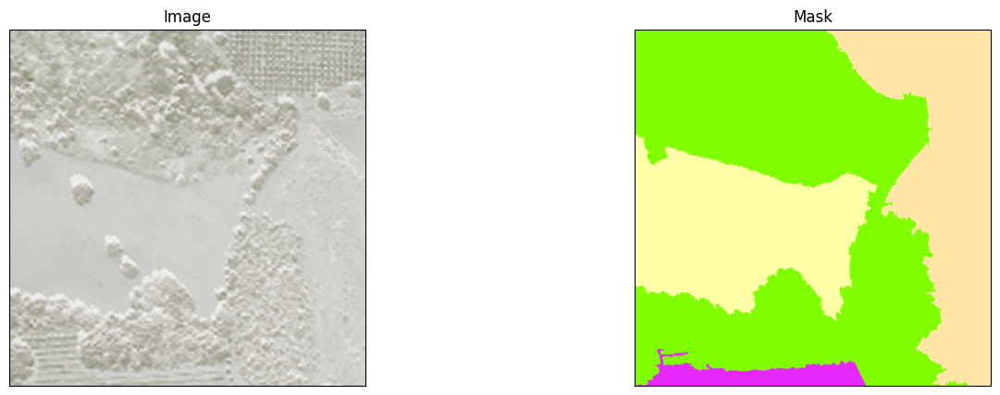

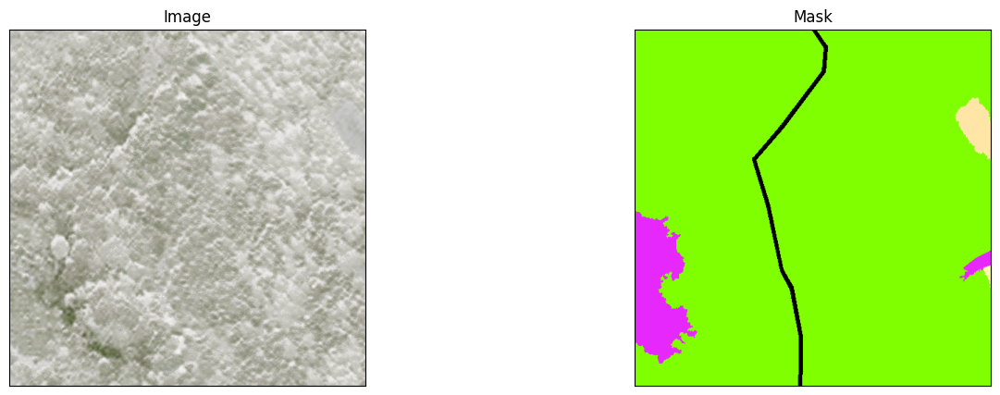

...

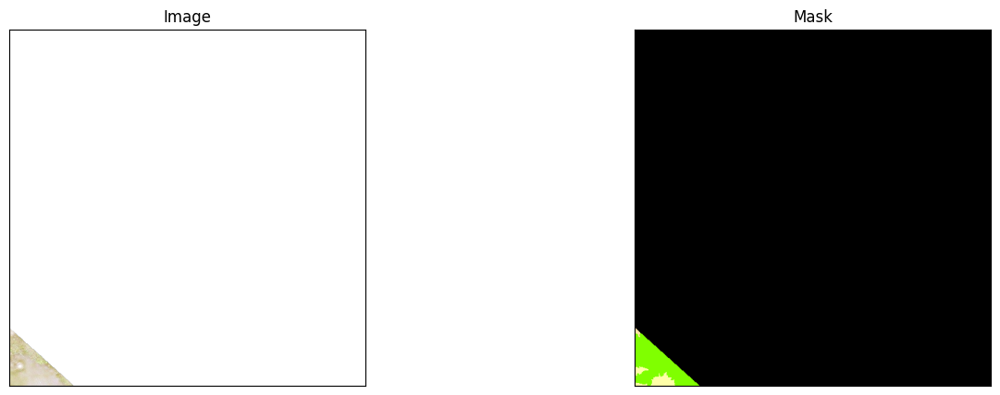

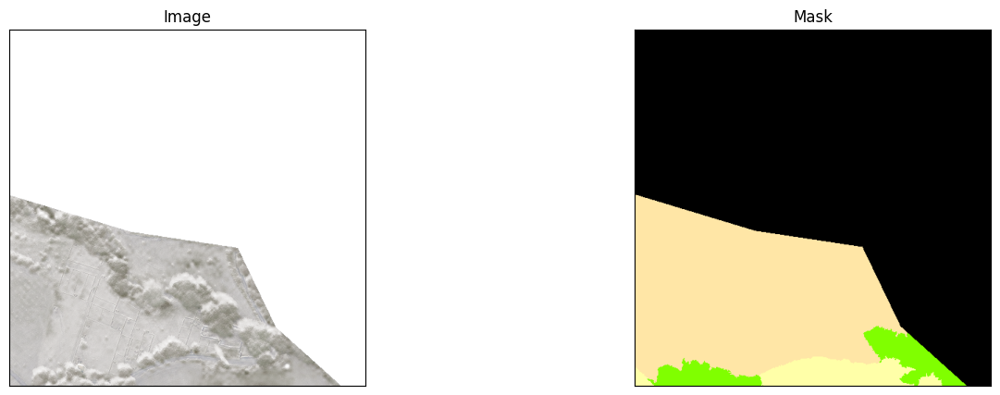

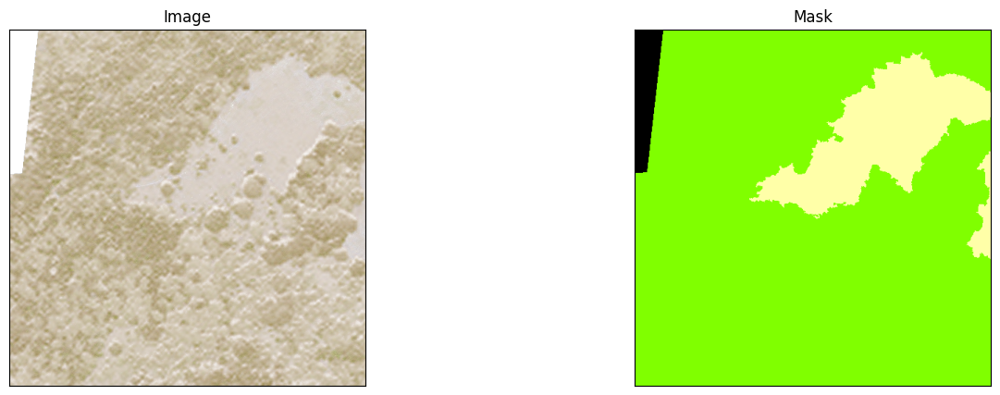

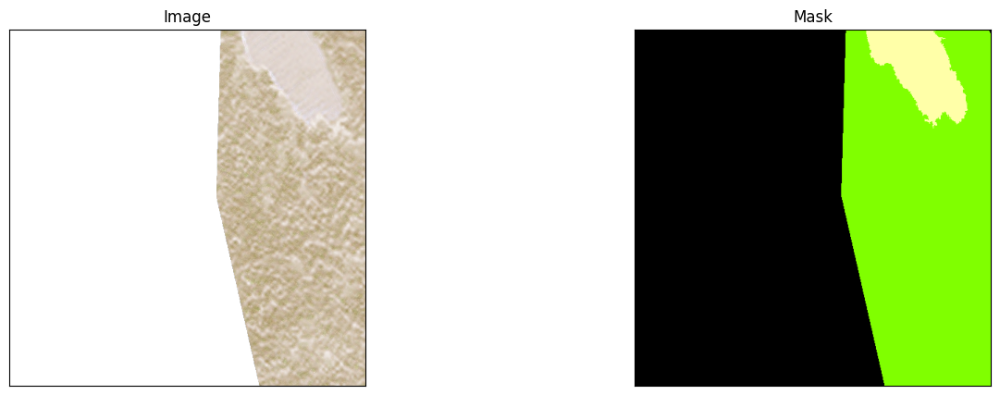

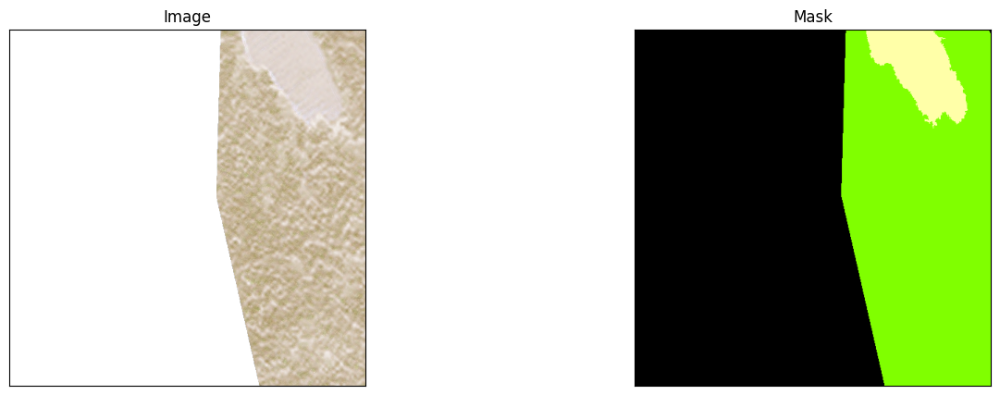

In [11]:
for i in range(25):

    idx = np.random.randint(0,len(val_dataset))
    image, mask = val_dataset[idx]

    im = image.detach().cpu().numpy()
    image = np.transpose(im, (1,2,0))

    # Check for invalid values
    if np.any(np.isnan(image)) or np.any(np.isinf(image)):
        print("Found NaN or inf! Filtering...")
        image[np.isnan(image)] = 0
        image[np.isinf(image)] = 0

    # Normalize each channel independently
    image = image.astype('float32')
    image -= image.min(axis=(0,1), keepdims=True)
    
    # Avoid divide by zero 
    image /= (image.max(axis=(0,1), keepdims=True) + 1e-7)
    
    # Clip values before casting to uint8
    image *= 255
    image = np.clip(image, 0, 255).astype('uint8')

    mask = mask.detach().cpu().numpy()
    gt_mask = np.transpose(mask, (1,2,0))
    gt_max = np.argmax(gt_mask, axis=-1)
    gt_color = convert_to_color(gt_max)

    visualize_in_one_row(Image=image,  
                         Mask=gt_color)

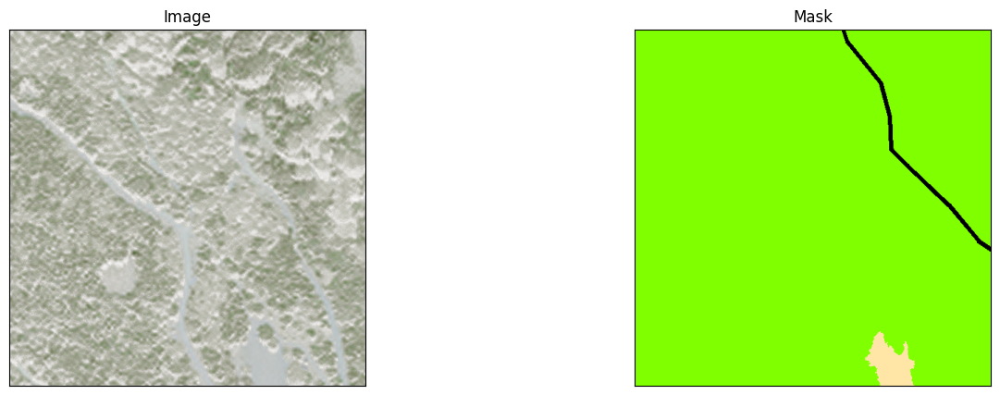

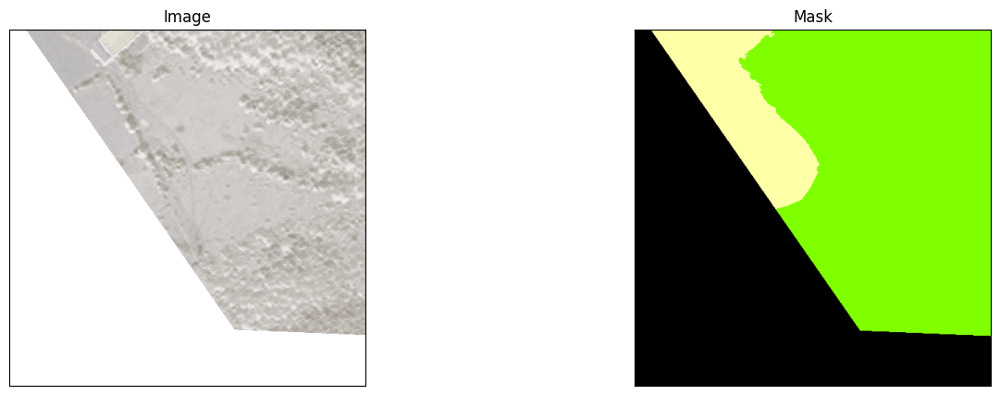

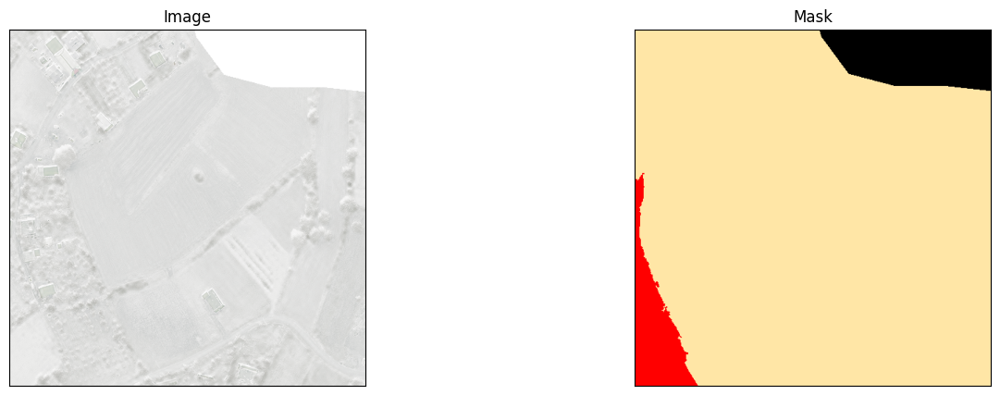

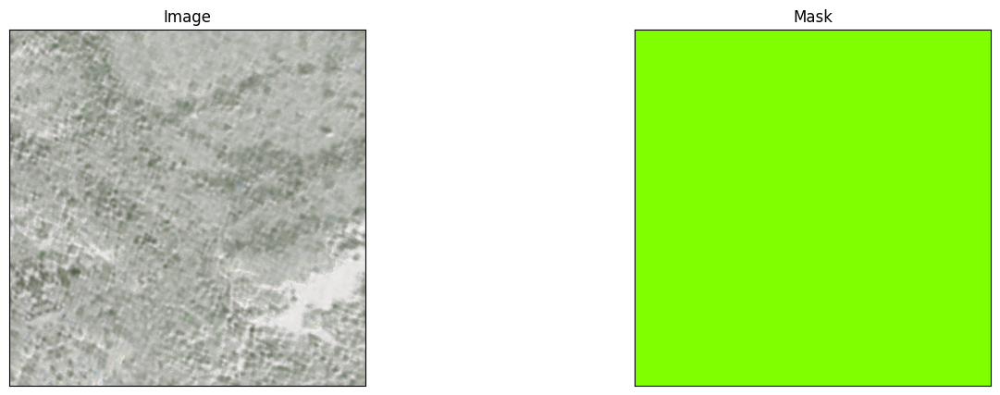

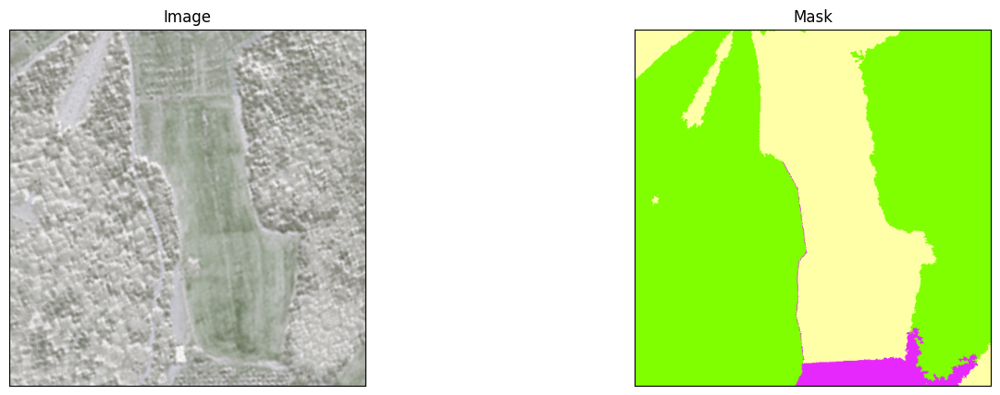

...

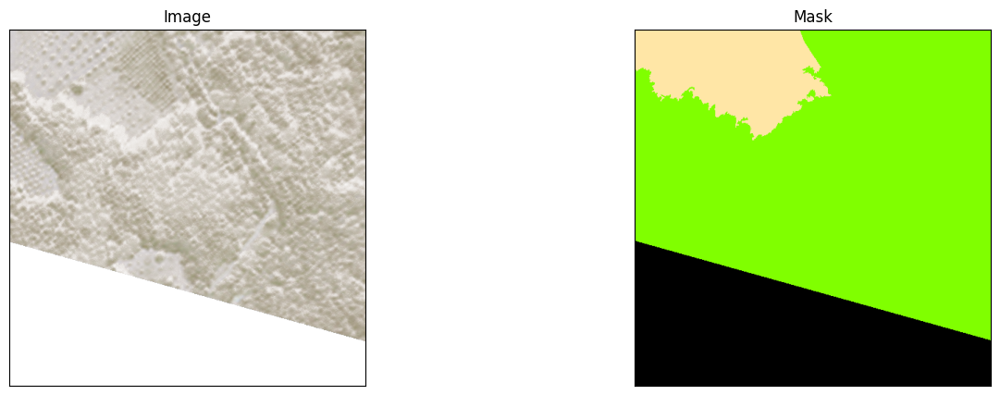

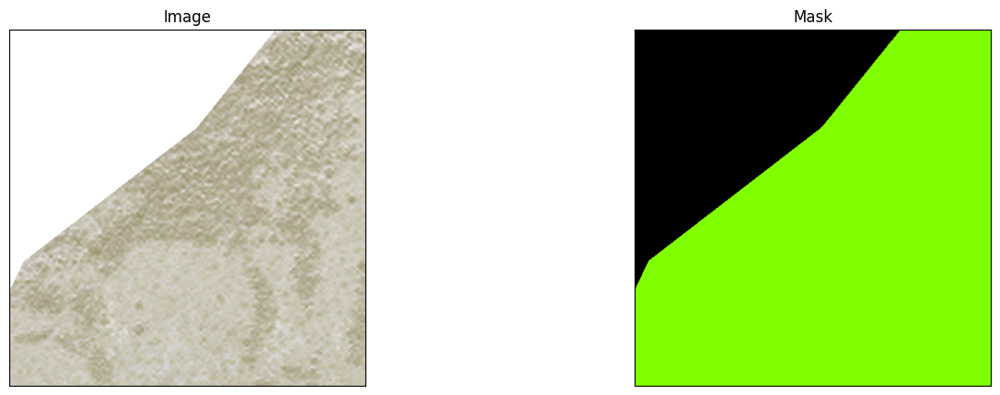

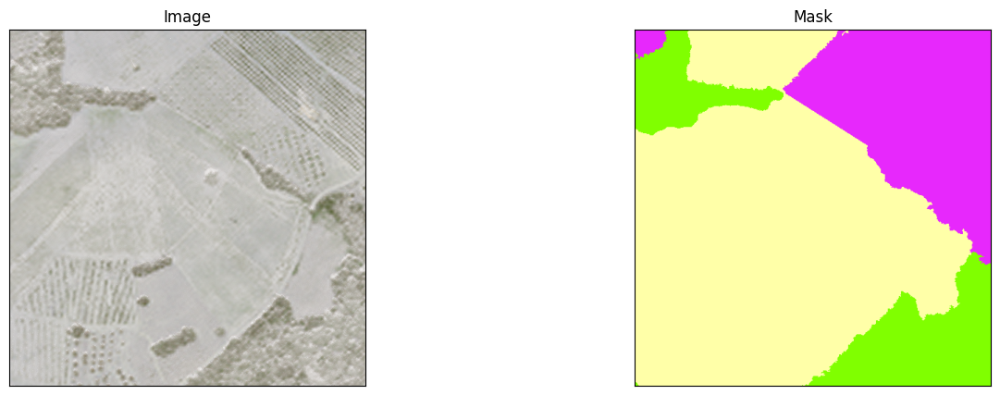

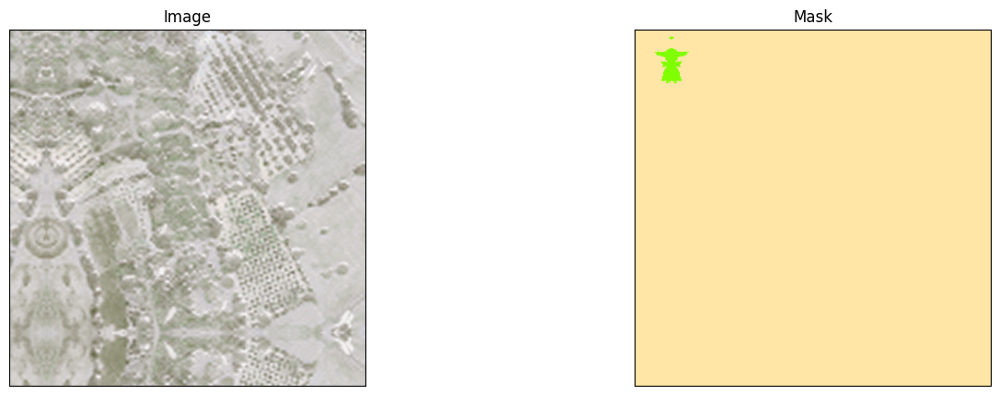

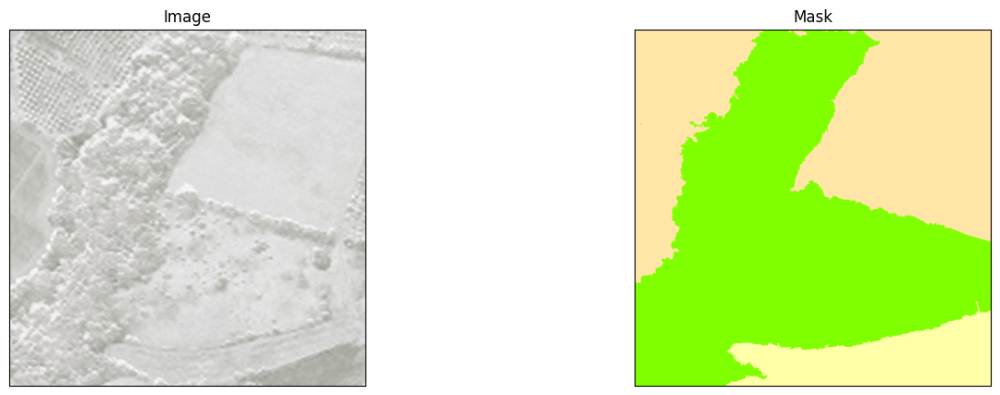

In [12]:
for i in range(25):

    idx = np.random.randint(0,len(train_dataset))
    image, mask = train_dataset[idx]

    im = image.detach().cpu().numpy()
    image = np.transpose(im, (1,2,0))

    # Check for invalid values
    if np.any(np.isnan(image)) or np.any(np.isinf(image)):
        print("Found NaN or inf! Filtering...")
        image[np.isnan(image)] = 0
        image[np.isinf(image)] = 0

    # Normalize each channel independently
    image = image.astype('float32')
    image -= image.min(axis=(0,1), keepdims=True)
    
    # Avoid divide by zero 
    image /= (image.max(axis=(0,1), keepdims=True) + 1e-7)
    
    # Clip values before casting to uint8
    image *= 255
    image = np.clip(image, 0, 255).astype('uint8')

    mask = mask.detach().cpu().numpy()
    gt_mask = np.transpose(mask, (1,2,0))
    gt_max = np.argmax(gt_mask, axis=-1)
    gt_color = convert_to_color(gt_max)

    visualize_in_one_row(Image=image,  
                         Mask=gt_color)

### Hyperparameters

In [9]:
n_classes = len(palette)
activation = 'softmax'
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
DEVICE = 'cuda'
batch_s = 4
in_ch = 4
lr = 1e-5
n_of_epochs = 100

log_path = '/kaggle/working'

experiment_log = 'unetrmsresnet'

### Model definition 

In [10]:
net = smp.UnetPlusPlus(ENCODER, classes=n_classes, activation=activation, in_channels=in_ch,encoder_weights=ENCODER_WEIGHTS )
net = net.cuda()

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 208MB/s]


### Loss function 

In [11]:

focal = smp.losses.FocalLoss(mode='multilabel', ignore_index=[0])
focal.__name__ = 'Focal'

dice = smp.losses.DiceLoss(mode='multilabel', ignore_index=[0])
dice.__name__ = 'Dice'

loss = JointLoss(dice_weight=1, focal_weight=0.5)
loss.__name__ = "DF"

In [12]:
train_loader = DataLoader(train_dataset, batch_size=batch_s, sampler = train_sampler)#, shuffle=True)#, collate_fn=collate_fn)
valid_loader = DataLoader(val_dataset, batch_size=batch_s, sampler = val_sampler) #, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_s, shuffle=False)#, collate_fn=collate_fn)

In [13]:
metrics = [smp.utils.metrics.IoU(threshold=0.5, ignore_channels = [0]), 
            smp.utils.metrics.Fscore(threshold=0.5, ignore_channels = [0]),
            smp.utils.metrics.Precision(threshold=0.5, ignore_channels = [0]),
            smp.utils.metrics.Recall(threshold=0.5, ignore_channels = [0])
]

optimizer = torch.optim.RMSprop([ 
    {'params': net.parameters(), 'lr': lr}
])

In [14]:
train_epoch = smp.utils.train.TrainEpoch(
    net, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    net, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

### Train 

In [15]:
def save_checkpoint(model, optimizer, epoch, max_score, log_path, experiment_log):
    state = {
        'epoch': epoch + 1,  
        'state_dict': model.state_dict(),
        'optimizer': optimizer.state_dict(),
        'max_score': max_score
    }
    filename = os.path.join(log_path, f'{experiment_log}_checkpoint.pth')
    torch.save(state, filename)

def load_checkpoint(model, optimizer, log_path, experiment_log):
    checkpoint_filename = os.path.join(log_path, f'{experiment_log}_checkpoint.pth')
    if os.path.isfile(checkpoint_filename):
        checkpoint = torch.load(checkpoint_filename)
        model.load_state_dict(checkpoint['state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer'])
        return checkpoint['epoch'], checkpoint['max_score']
    else:
        return 0, 0  


def save_best_model(model, log_path, experiment_log, best_score, current_score):
    # check the best score and save the model
    if current_score > best_score:
        best_score = current_score
        model_file = os.path.join(log_path, f'{experiment_log}.pth')
        torch.save(model, model_file)
        print('Model saved at {}'.format(model_file))
    return best_score


start_epoch, max_score = load_checkpoint(net, optimizer, log_path, experiment_log)

# training cycle
for epoch in range(start_epoch, n_of_epochs):
    print(f'\nEpoch: {epoch}')
    
    train_logs = train_epoch.run(train_loader)
    valid_logs = valid_epoch.run(valid_loader)
    
    # save best model
    max_score = save_best_model(net, log_path, experiment_log, max_score, valid_logs['iou_score'])
    
    # checkpoint - end of the every epoch
    save_checkpoint(net, optimizer, epoch, max_score, log_path, experiment_log)




Epoch: 66
train:   0%|          | 0/524 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/segmentation_models_pytorch/base/modules.py:116: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return self.activation(x)


valid: 100%|██████████| 150/150 [01:38<00:00,  1.52it/s, DF - 0.6892, iou_score - 0.2375, fscore - 0.3769, precision - 0.3794, recall - 0.3745]

Epoch: 67
valid: 100%|██████████| 150/150 [01:35<00:00,  1.57it/s, DF - 0.6849, iou_score - 0.3646, fscore - 0.5183, precision - 0.4872, recall - 0.5628]

Epoch: 68
valid: 100%|██████████| 150/150 [01:35<00:00,  1.57it/s, DF - 0.6678, iou_score - 0.672, fscore - 0.7972, precision - 0.7618, recall - 0.8431] 

Epoch: 69
valid: 100%|██████████| 150/150 [01:35<00:00,  1.57it/s, DF - 0.645, iou_score - 0.7573, fscore - 0.8582, precision - 0.8581, recall - 0.8582] 

Epoch: 70
valid: 100%|██████████| 150/150 [01:35<00:00,  1.57it/s, DF - 0.6596, iou_score - 0.7406, fscore - 0.8453, precision - 0.8459, recall - 0.8447]

Epoch: 71
valid: 100%|██████████| 150/150 [01:36<00:00,  1.56it/s, DF - 0.6847, iou_score - 0.3871, fscore - 0.5517, precision - 0.5522, recall - 0.5512]

Epoch: 72
valid: 100%|██████████| 150/150 [01:33<00:00,  1.60it/s, DF - 0.7105, 

In [16]:
os.path.exists(os.path.join(log_path, '{}.pth'.format(experiment_log)))

True

In [17]:
best_model = torch.load(os.path.join(log_path, '{}.pth'.format(experiment_log)))


In [18]:
best_model.cuda()

UnetPlusPlus(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(4, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential

### Evaluation & Inference 

In [19]:
test_epoch = smp.utils.train.ValidEpoch(
    model=best_model,
    loss=loss,
    metrics=metrics,
    device=DEVICE,
)

logs = test_epoch.run(test_loader)

valid: 100%|██████████| 15/15 [00:12<00:00,  1.19it/s, DF - 0.464, iou_score - 0.7884, fscore - 0.8789, precision - 0.8787, recall - 0.8791] 


In [20]:
logs

{'DF': 0.4639805773893992,
 'iou_score': 0.7884454528490702,
 'fscore': 0.8788859923680624,
 'precision': 0.8786895553270977,
 'recall': 0.8790902296702067}

/tmp/ipykernel_42/4164520222.py:11: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  tensor = torch.unsqueeze(torch.tensor(x_tensor), axis = 0)
/tmp/ipykernel_42/4164520222.py:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  tensor = torch.tensor(tensor, device = 'cuda')


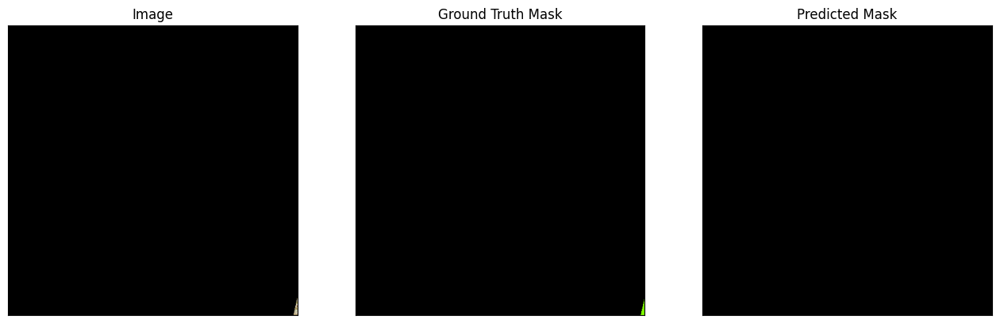

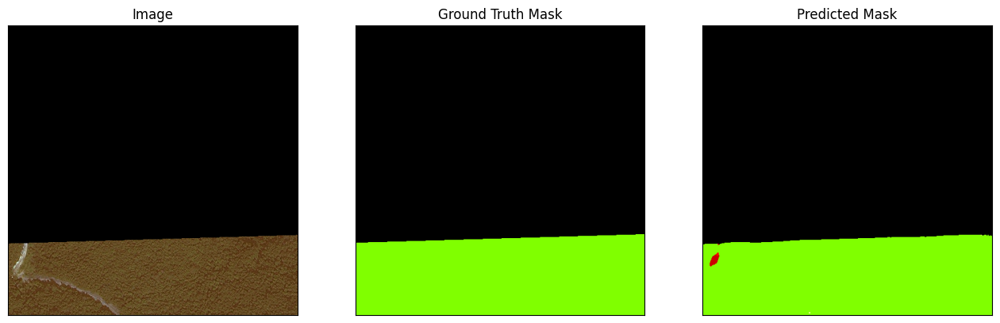

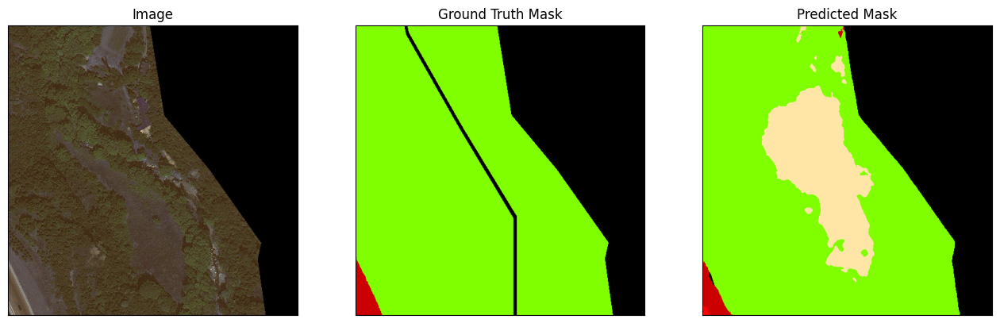

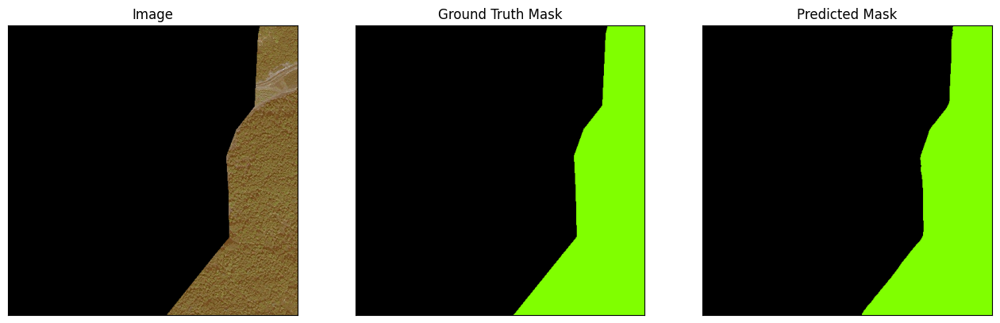

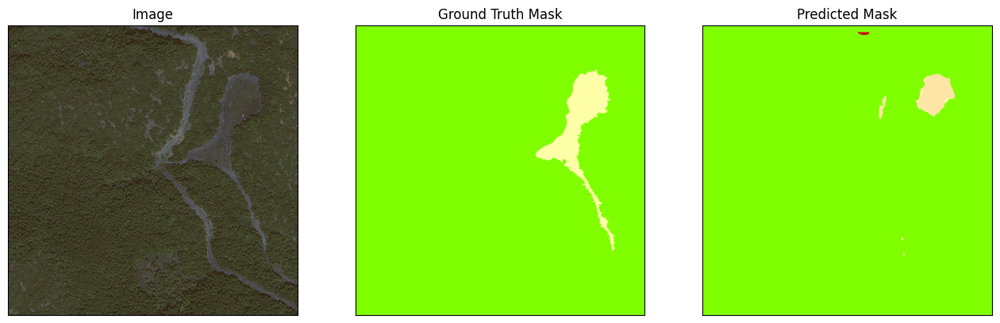

...

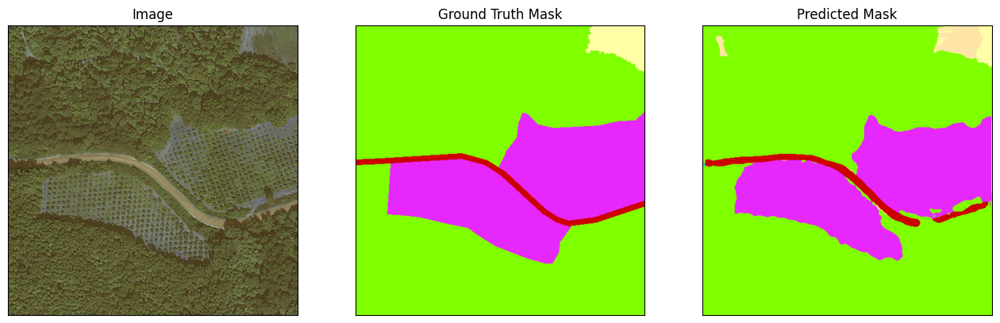

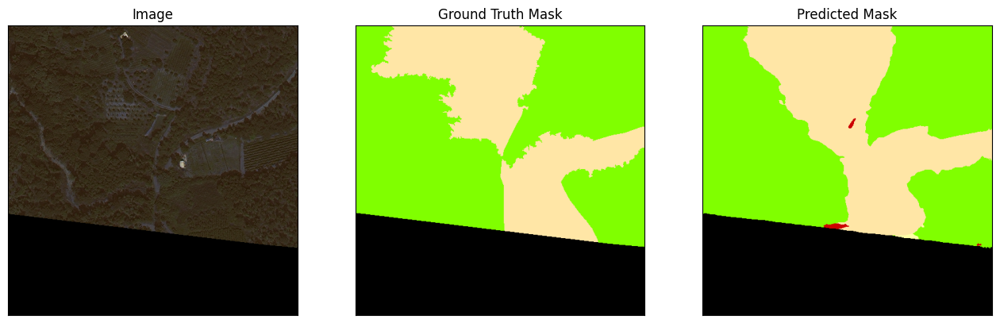

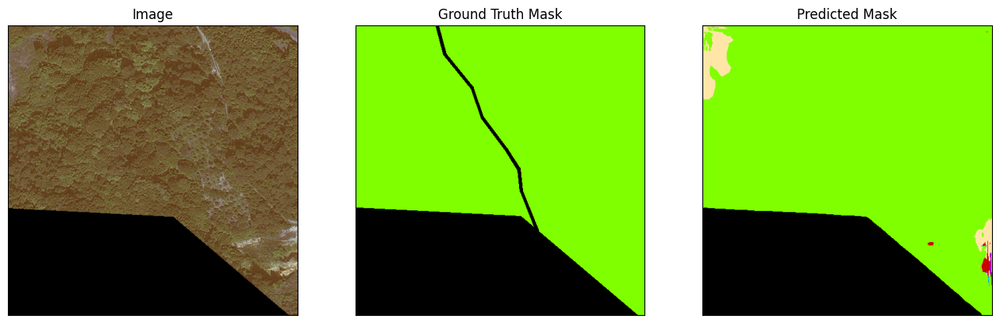

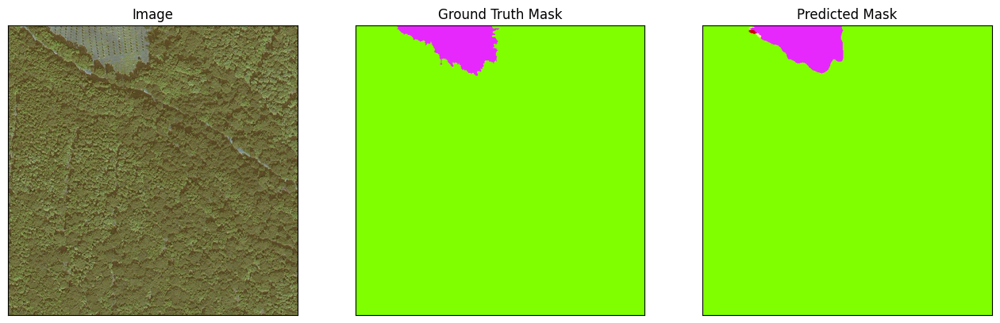

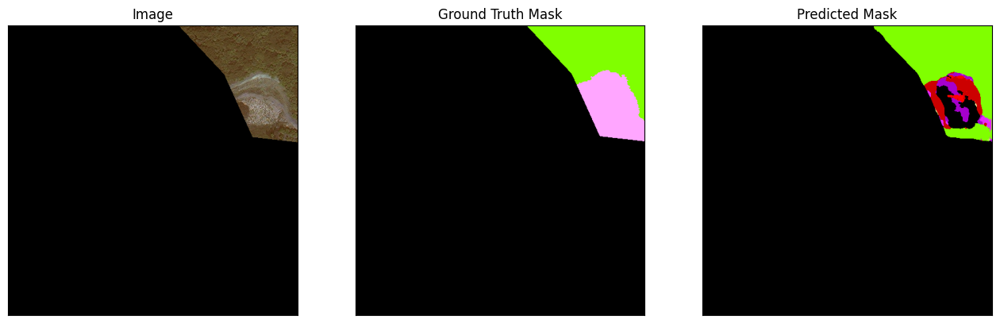

In [21]:
for i in range(len(test_dataset)):
    
    image = np.transpose(test_dataset[i][0].detach().cpu().numpy(),(1,2,0))
    viz_im = np.array([scale_range(i, 0, 255) for i in image.transpose((2,0,1))]).transpose(1,2,0)[...,:3].astype(np.uint8)
    #viz_im = np.array([scale_range(i, 0, i.max()) for i in image.transpose((2,0,1))]).transpose(1,2,0)[...,:3].astype(np.uint8)
    gt_mask = np.transpose(test_dataset[i][1].detach().cpu().numpy(),(1,2,0))
    gt_max = np.argmax(gt_mask, axis=-1)
    gt_color = convert_to_color(gt_max)    

    x_tensor = test_dataset[i][0]
    tensor = torch.unsqueeze(torch.tensor(x_tensor), axis = 0)
    tensor = tensor.float() 
    tensor = torch.tensor(tensor, device = 'cuda')
    #tensor = tensor.to('cuda')
    
    pr_mask = best_model.predict(tensor).detach().cpu().numpy()
    pr_max  = np.argmax(pr_mask, 1)
    pr_max = np.transpose(pr_max, (1,2,0)).squeeze()
    pr_max11 = convert_to_color(pr_max)

    visualize_in_one_row(
            image=viz_im,  #ımage torch.Size([512, 512, 4])
            ground_truth_mask=gt_color,  #gt_color (512, 512, 3)
            predicted_mask=pr_max11) #pr_max11 (512, 512, 3)

## Class-wise metrics

In [22]:
y_preds, ys = evaluate(best_model, test_dataset)

100%|██████████| 60/60 [00:10<00:00,  5.75it/s]


In [23]:
y_preds = np.asarray(y_preds)
ys = np.asarray(ys)

F1 = f1_score(ys.flatten(), y_preds.flatten(), average=None)
Precision = precision_score(ys.flatten(), y_preds.flatten(), average=None)
Recall = recall_score(ys.flatten(), y_preds.flatten(), average=None)
a = (F1.flatten(), Precision.flatten(), Recall.flatten())

f1 = np.asarray(F1)
prec = np.asarray(Precision)
rec = np.asarray(Recall)

metrics = np.stack((f1, prec, rec), axis = 1)
metrics

/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


array([[0.98367642, 0.98882003, 0.97858604],
       [0.9332726 , 0.92831291, 0.93828556],
       [0.83746977, 0.93684643, 0.7571541 ],
       [0.57930662, 0.58953183, 0.56943007],
       [0.80760451, 0.87466289, 0.75009637],
       [0.79265068, 0.89469168, 0.71150268],
       [0.84112626, 0.78906787, 0.90053891],
       [0.81673119, 0.91784547, 0.73568462],
       [0.9673274 , 0.95884863, 0.97595745],
       [0.        , 0.        , 0.        ]])

In [24]:
jaccard = jaccard_score(ys.flatten(), y_preds.flatten(), average=None)

In [25]:
f1.mean()

0.7559165448225225

In [26]:
jaccard.mean()

0.6657505171276772

In [27]:
prec.mean()

0.7878627730168224

In [28]:
rec.mean()

0.7317235809161741

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

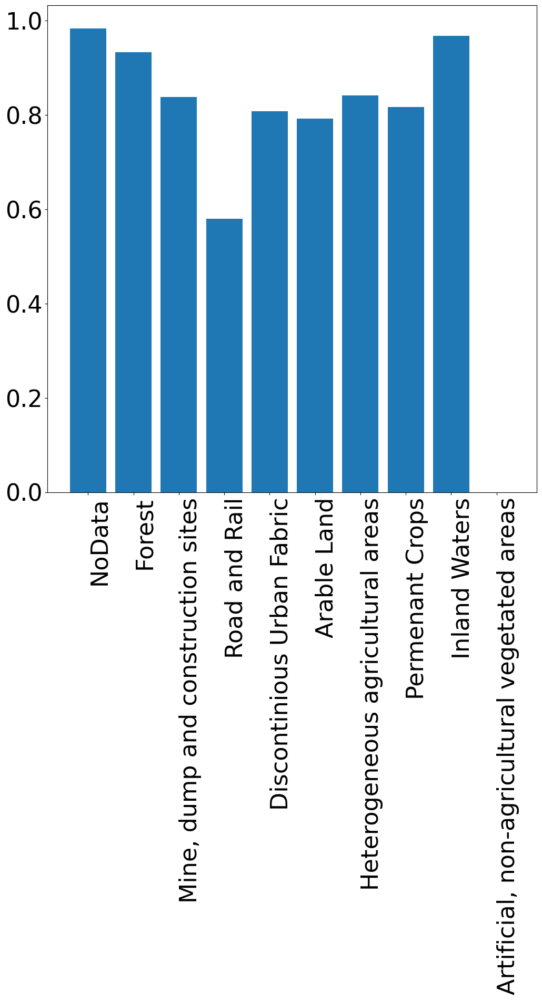

In [29]:
import matplotlib.pyplot as plt
f1 = [0.98367642, 0.9332726, 0.83746977, 0.57930662 ,0.80760451,
       0.79265068, 0.84112626, 0.81673119, 0.9673274, 0.]


params = {'font.size': 52,
              'xtick.labelsize':32,
              'ytick.labelsize':32}
plt.rcParams.update(params)

fig, ax = plt.subplots(figsize=(12, 12))

plt.bar(Class_names, f1)
plt.setp(ax.get_xticklabels(), rotation=90, ha="right",
             rotation_mode="anchor")

###  Confusion Matrix

In [30]:
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib 
from sklearn.utils.multiclass import unique_labels
from sklearn.metrics import confusion_matrix 

def plot_confusion_matrix(ys,
                          y_preds,
                          classes,
                          normalize=False,
                          cmap=plt.cm.Greys):

    params = {'font.size': 22,
              'xtick.labelsize':27,
              'ytick.labelsize':27}
    matplotlib.rcParams.update(params)

    cm = confusion_matrix(ys.flatten(), y_preds.flatten())

    if normalize:
         cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
         print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')
           
    fig, ax = plt.subplots(figsize=(30, 30))

    im = ax.imshow(cm, interpolation='nearest', cmap=cmap, origin = 'upper') 
    #ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes)
           #ylabel='True label',
           #xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.tight_layout()
    plt.setp(ax.get_xticklabels(), rotation=90, ha="right",
             rotation_mode="anchor")
    # Loop over data dimensions and create text annotations.
    fmt = '.3f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            if cm[i,j] == 0.:
                continue
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    #plt.savefig('Confusion-NWPU_enumerated_FINAL.svg', pad_inches = 0, transparent=False, bbox_inches='tight')
    return ax

Normalized confusion matrix


<Axes: >

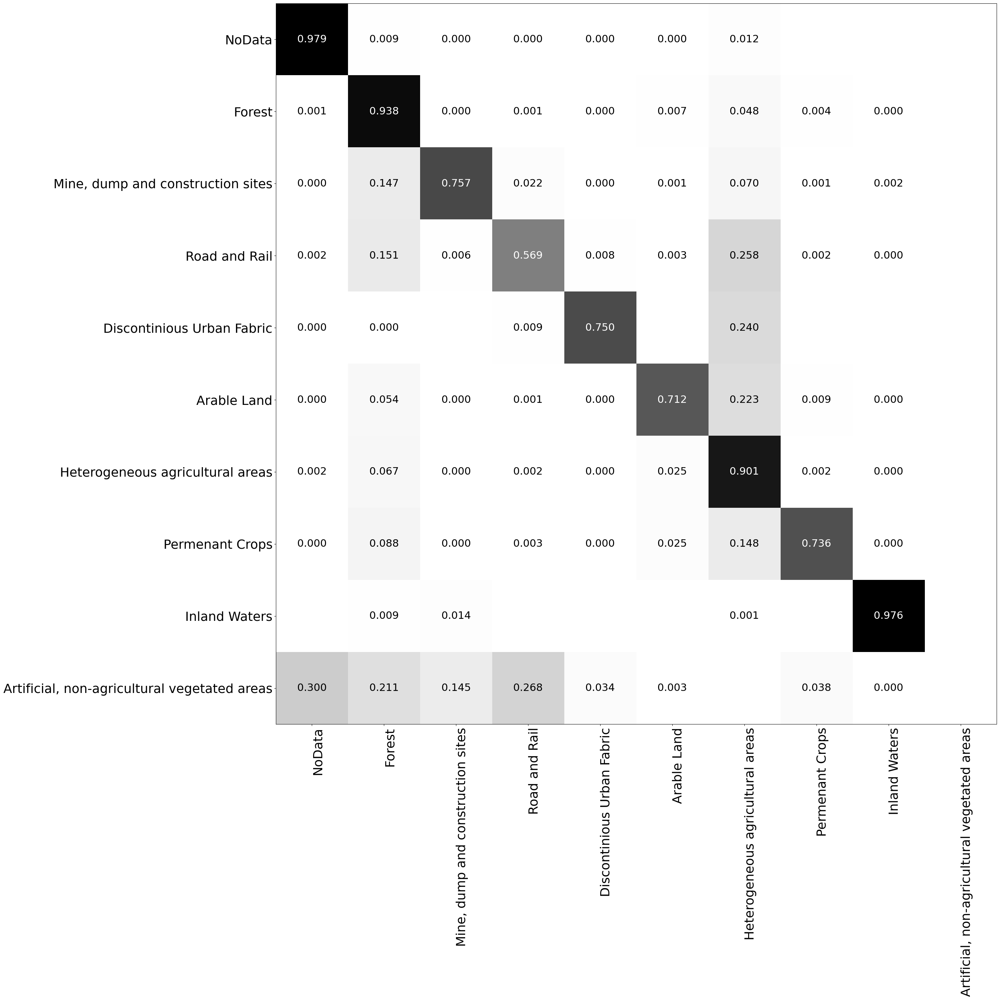

In [31]:
plot_confusion_matrix(ys=ys,
                      y_preds=y_preds,
                      classes=Class_names,
                      normalize=True)

### End 